<a href="https://colab.research.google.com/github/valentina-s/stand_mapping/blob/master/notebooks/0X_Sandbox/valentina_discriminative_loss_training_stand_mapping_validation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This is a modificaiton of Unet Segmentation with Discriminative Loss:

https://github.com/nyoki-mtl/pytorch-discriminative-loss

[Semantic Instance Segmentation with a Discriminative Loss Function](https://arxiv.org/abs/1708.02551)

In this version we have set the discriminative cost to zero, and removed all instance references. It requires the branch `stand-mapping` from https://github.com/valentina-s/pytorch-discriminative-loss.

### Experiment 1

Vanilla U-net:

4 inputs: NAIP

5 targets: 1=water, 2=forest, 3=field, 4=barren, 5=developed

In [1]:
import numpy as np
import os
import glob

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset, SubsetRandomSampler
from torch.autograd import Variable
from torchvision import transforms
from tqdm.notebook import tqdm

In [2]:
import matplotlib.pyplot as plt

In [3]:
import pandas as pd

In [4]:
import torchvision

In [5]:
# Resource Performance Monitor
from urllib.request import urlopen
exec(urlopen("http://colab-monitor.smankusors.com/track.py").read())
_colabMonitor = ColabMonitor().start()

Now live at : http://colab-monitor.smankusors.com/6045f7a7c4df2


In [6]:
# Load the TensorBoard notebook extension
%reload_ext tensorboard

In [7]:
from torch.utils.tensorboard import SummaryWriter

In [8]:
# Writer will output to ./runs/ directory by default
writer = SummaryWriter(log_dir='runs/')

In [9]:
# setting the devicide to cuda if available
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

Before running download the model from [model.pth](https://drive.google.com/drive/folders/1ihcqYr9PptELUZjHVL7jT4LXB3VpfxNt), and put it under `pytorch-discriminative-loss/model/`

In [10]:
import sys
sys.path.remove('/gdrive/stand_mapping')
sys.path.remove('/gdrive/stand_mapping/stand_mapping')

In [11]:
sys.path

['/home/d-diaz/anaconda3/envs/stand_mapping/lib/python36.zip',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/lib-dynload',
 '',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/IPython/extensions',
 '/home/d-diaz/.ipython']

In [12]:
# import sys
# sys.path.append('../../stand_mapping/')

In [13]:
import sys
# sys.path.append('../../stand_mapping/')
sys.path.append('/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/')

In [14]:
sys.path

['/home/d-diaz/anaconda3/envs/stand_mapping/lib/python36.zip',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/lib-dynload',
 '',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages',
 '/home/d-diaz/anaconda3/envs/stand_mapping/lib/python3.6/site-packages/IPython/extensions',
 '/home/d-diaz/.ipython',
 '/home/d-diaz/stand_mapping_valentina_fork/stand_mapping/']

In [15]:
ls

TensorBoardTest.ipynb
models/
runs/
runs_test/
valentina_discriminative_loss_training_stand_mapping_validation.ipynb


In [16]:
from models.unet import UNet
from utils.criterion import DiscriminativeLoss

In [17]:
# set the number of input and output classes
N_CLASSES = 5
N_CHANNELS = 4

In [18]:
# Initialize the model (set number of input and output channels)
model = UNet(in_ch=N_CHANNELS, out_ch=N_CLASSES).to(device)

In [19]:
# load drive
#from google.colab import drive
#drive.mount('/content/drive', force_remount=True)

In [20]:
ROOT_DIR = '/gdrive/stand_mapping/data/processed/training_tiles/'

In [21]:
from data.dataset import SemanticDataset
# from stand_mapping.data.dataset import SemanticDataset

In [22]:
input_transformer = transforms.Compose([
    transforms.Resize((256,256), interpolation=2), # bilinear interpolation to 256x256
    # transforms.Normalize(naip_rgb_mean, naip_rgb_std),
    # transforms.Normalize(naip_chip_mean, naip_chip_std),
])

target_transformer = transforms.Compose([
    transforms.Resize((256,256), interpolation=0), # nearest neighbor interpolation to 256x256
])

In [23]:
help(SemanticDataset)

Help on class SemanticDataset in module data.dataset:

class SemanticDataset(torch.utils.data.dataset.Dataset)
 |  An abstract class representing a :class:`Dataset`.
 |  
 |  All datasets that represent a map from keys to data samples should subclass
 |  it. All subclasses should overwrite :meth:`__getitem__`, supporting fetching a
 |  data sample for a given key. Subclasses could also optionally overwrite
 |  :meth:`__len__`, which is expected to return the size of the dataset by many
 |  :class:`~torch.utils.data.Sampler` implementations and the default options
 |  of :class:`~torch.utils.data.DataLoader`.
 |  
 |  .. note::
 |    :class:`~torch.utils.data.DataLoader` by default constructs a index
 |    sampler that yields integral indices.  To make it work with a map-style
 |    dataset with non-integral indices/keys, a custom sampler must be provided.
 |  
 |  Method resolution order:
 |      SemanticDataset
 |      torch.utils.data.dataset.Dataset
 |      typing.Generic
 |      bu

In [24]:
df = pd.read_csv('/gdrive/stand_mapping/data/processed/training_tiles/tileindex.csv')
# subsampling to test on small dataset
df = df.sample(200).reset_index()
ds = SemanticDataset(root='/gdrive/stand_mapping/data/processed', 
                     dataframe=df, raw_chip_size=512, use_layers={'naip': True},
                     transform=target_transformer, target_transform=target_transformer) 
#res = ds[1]
#res[0].shape

In [25]:
naip_chip_mean = [74.77060828, 92.60867138, 81.82211117, 122.17832602]  # R, G, B, NIR
naip_chip_std = [31.83725084, 30.74003338, 16.31047271, 43.92487841]  # R, G, B, NIR
naip_rgb_mean = [74.77060828, 92.60867138, 81.82211117]
naip_rgb_std = [31.83725084, 30.74003338, 16.31047271]

In [26]:
# here we create train, validation, and test datasets
# we would create a train and test datasets; 
# further, the train dataset will be used for training and validation:
# it will be accessed by the train and validation dataloaders

In [27]:
# here we create train and test dataloaders

In [28]:
# create indeces to split train_dataset further to train and validation sets
def train_val_split_sampler(dataset, train_val_ratio):
    """
        Returns samplers which can split the dataset into train and validation in the data loaders
        
        Input
        
        train_val_ratio: the ration of the train and validation set size
        dataset: dataset for which indeces will be generated
        
        Output
        train_sampler
        val_sampler
        
    
    """
    dataset_size = len(dataset)
    indices = list(range(dataset_size))
    split = int(np.floor(train_val_ratio * dataset_size))
    train_indices, val_indices = indices[:split], indices[split:]
    train_sampler = SubsetRandomSampler(train_indices)
    val_sampler = SubsetRandomSampler(val_indices)
    
    return(train_sampler, val_sampler)
    


In [29]:
RATIO=0.8

In [30]:
train_sampler, val_sampler = train_val_split_sampler(ds, RATIO)

In [31]:
# train dataloader
train_dataloader = DataLoader(ds, batch_size=10,
                        num_workers=2, pin_memory=True,
                        sampler=train_sampler)


In [32]:
# validation dataloader
val_dataloader = DataLoader(ds, batch_size=10,
                        num_workers=2, pin_memory=True, 
                        sampler=val_sampler)

In [33]:
# test dataloader (need to leave out a dataset for testing)
# test_dataloader = DataLoader(test_dataset, batch_size=10,
#                        shuffle=True, num_workers=2, 
#                        pin_memory=True)

In [34]:
import matplotlib.pyplot as plt
class inverse_normalize:
    def __init__(self, mean, std):
        self.mean = mean
        self.std = std

    def __call__(self, y):
        x = y.new(*y.size())
        for i in range(x.shape[0]):
            x[i, :, :] = y[i, :, :] * self.std[i] + self.mean[i]
        return x

invert = inverse_normalize(naip_chip_mean, naip_chip_std)

In [35]:
from visualization.visualize import colorize_landcover 

In [36]:
cover = colorize_landcover(ds[0][1].squeeze())

In [37]:
COLOR_MAP = {
    0: [0,0,0], # none, nodata
    1: [0,0,1], # water
    2: [0,0.5,0], # trees
    3: [0.5,1,0.5], # field
    4: [1, 1, 1], # barren
    5: [0.5,0.375,0.375], # developed
}

def recolor_landcover(lc_img, cmap, soft=False, num_classes=4):
  cover_colors = np.zeros((lc_img.shape[0], lc_img.shape[1], 3))
  if not soft:
      for cov in np.unique(lc_img):
          mask = lc_img == cov
          cover_colors[mask] = cmap[cov]
  if soft: # we're given the probability of each class for each pixel
      for i in range(num_classes - 1):
          cover_colors[:,:,0] += lc_img[:,:,i] * cmap[i+1][0] # R
          cover_colors[:,:,1] += lc_img[:,:,i] * cmap[i+1][1] # G
          cover_colors[:,:,2] += lc_img[:,:,i] * cmap[i+1][2] # B

  return (cover_colors * 255).astype(np.uint8)

def recolor_landcover_batch(image_batch, cmap, soft=False, num_classes=4):
  """ recolor_landcover_batch applies the recolor_landcover function to a batch of images;
  the expectation is that the image_batch is of size batch_size, # channels, H,W
  """
  colored_image_batch = [torch.from_numpy(recolor_landcover(image_batch[i], cmap, soft=soft, num_classes = num_classes )) for i in range(image_batch.shape[0])]
  colored_image_stack = torch.stack(colored_image_batch, axis=0)
  
  return(colored_image_stack)

In [38]:
ds[0][0].max()

tensor(227.)

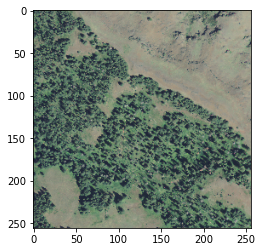

In [39]:
plt.imshow(ds[0][0][:3,:,:].permute(2,1,0).numpy().astype('int'))

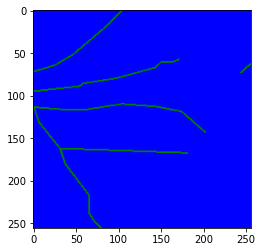

In [40]:
cover = colorize_landcover(ds[0][1].squeeze()+1)
plt.imshow(cover)

In [41]:
ds[0][1].unique()

tensor([0, 1])

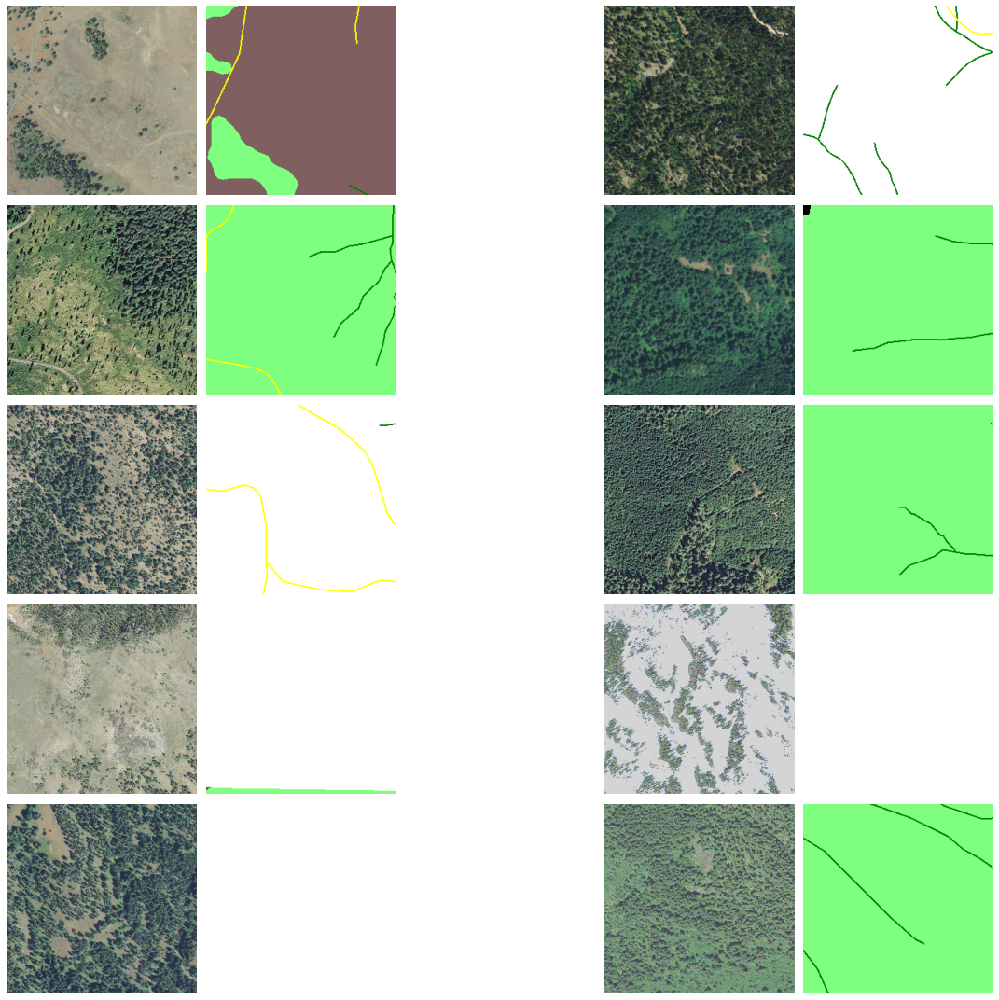

In [42]:
NUM_CHIPS = 10
fig, axs = plt.subplots(nrows=NUM_CHIPS//2, ncols=5, figsize=(5*3, 3*NUM_CHIPS//2))
for i in range(NUM_CHIPS):
  chip_num = np.random.randint(0, len(ds))
  row_num = i//2
  j = 0 if i % 2 == 0 else 3
  tile = ds[chip_num]
  axs[row_num, j].imshow(np.moveaxis(tile[0].numpy()[0:3,:,:], 0,-1).astype(np.uint8))
  cover = (tile[1]).numpy().squeeze().astype(np.uint8)+1
  nodata = (tile[2]).numpy().squeeze()
  cover[nodata] = 0
  cover_color = colorize_landcover(cover)
  axs[row_num, j+1].imshow(cover_color)
  # axs[row_num, j+1].imshow(ds[chip_num][2].numpy().squeeze())

for ax in axs.ravel():
    ax.axis('off')

plt.tight_layout()
plt.show()

In [43]:
# Loss Function
criterion_ce = nn.CrossEntropyLoss(reduction='none').to(device)

In [44]:
# Optimizer
parameters = model.parameters()
optimizer = optim.SGD(parameters, lr=0.01, momentum=0.9, weight_decay=0.001)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer=optimizer,
                                                 mode='min',
                                                 factor=0.1,
                                                 patience=10,
                                                 verbose=True)

Run a training loop.

In [45]:
# from stand_mapping.stand_mapping.utils import scoring

In [46]:
#%tensorboard --logdir=/content/runs
#%tensorboard --logdir=runs

In [47]:
# ls ../../stand_mapping/utils

In [48]:
# import sys
# sys.path.append("../../stand_mapping/utils")

In [49]:
from utils.metrics import batchify
from utils.scoring import masks_iou, mask_f1_score, boundary_f1_score

In [50]:
writer = SummaryWriter(comment="SemSeg")

import warnings
#part of the message is also okay
warnings.filterwarnings("ignore", message="Default upsampling behavior") 

# Train
model_dir = ('models')
os.makedirs(model_dir, exist_ok=True)

best_loss = np.inf
NUM_EPOCHS = 5
for epoch in range(NUM_EPOCHS):
    
    ### Training ###
    with tqdm(total=int(np.ceil(RATIO*len(ds) / 10)), # 10 samples per batch
              desc=f'epoch {epoch+1}') as pbar:
        # print(f'epoch : {epoch+1}', end=' ')

        model.train()
        disc_losses = []
        ce_losses = []

        batch_num = 1
        for batched in train_dataloader:
            
            images, sem_labels, nodata = batched

            images = Variable(images).to(device)
            sem_labels = Variable(sem_labels).to(device)
            nodata = Variable(nodata).to(device)

            model.zero_grad()
            sem_predict = model(images)

            # calculate loss within mask
            loss = 0            
            mask = ~nodata
            ce_loss = criterion_ce(sem_predict, sem_labels.squeeze())
            ce_loss = mask*ce_loss
            ce_loss = torch.sum(ce_loss.flatten(start_dim=1), axis=0) # Sums the loss per image
            ce_loss = torch.mean(ce_loss) # loss per batch
            loss += ce_loss
            ce_losses.append(ce_loss.cpu().data.numpy())

            
            
            loss.backward()
            optimizer.step()
            pbar.update()

        ce_loss = np.mean(ce_losses)
        print(f'Train CrossEntropyLoss: {ce_loss:.4f}', end = ' ')
        loss = ce_loss
        
        # save model based on ce_loss (not discriminative)
        if loss < best_loss:
            best_loss = loss
            modelname = 'exp002_model.pth'
            torch.save(model.state_dict(), os.path.join(model_dir, modelname))

        

    ### Validation ###
    with torch.no_grad():
        model.eval()
        val_losses = []
        f1_scores = []
        for batched in val_dataloader:
            
            images, sem_labels, nodata = batched
            images = Variable(images).to(device)
            sem_labels = Variable(sem_labels).to(device)
            nodata = Variable(nodata).to(device)

            model.zero_grad()

            sem_predict = model(images)            
            model.eval()
            
              
            # calculate loss within mask
            mask = ~nodata
            val_loss = criterion_ce(sem_predict, sem_labels.squeeze())
            val_loss = mask*val_loss
            val_loss = torch.sum(val_loss.flatten(start_dim=1), axis=0) # Sums the loss per image
            val_loss = torch.mean(val_loss) # loss per batch
            val_losses.append(val_loss.cpu().data.numpy())

            # calculate iou for a batch
            f1_scores.append(batchify( sem_labels.cpu().squeeze(), sem_predict.argmax(dim=1).cpu().squeeze(), nodata.cpu().squeeze(), mask_f1_score))
            # f1_score_b = batchify(boundary_f1_score(sem_labels.cpu(), sem_predict.cpu(), nodata.cpu()))
              
        val_loss = np.mean(val_losses)
        print(f'Validation CrossEntropyLoss: {val_loss:.4f}', end = ' ')
        
        
        ### Tensorboard Logging ###

        # log losses
        writer.add_scalars("Losses",{'train_loss': loss,'val_loss': val_loss}, epoch)
        writer.flush()
        
        # log metrics
        iou_score, f1_score, precision, recall = f1_scores[-1]
        writer.add_scalars("Metrics",{'iou': iou_score,'f1': f1_score, 'precision': precision, 'recall': recall}, epoch)
        writer.flush()   
    
        # log training images
        normalized_images = (images.cpu()*torch.tensor(np.array(naip_chip_std).reshape(1,4,1,1))+torch.tensor(np.array(naip_chip_mean).reshape(1,4,1,1)))[:,:3,:,:]
        img_grid = torchvision.utils.make_grid(normalized_images, nrow=normalized_images.shape[0])
        writer.add_image('Validation Images Batch', img_grid.numpy().astype('uint8'), epoch)
        writer.flush()

        # log predicted images
        pred_recolor = recolor_landcover_batch(sem_predict.argmax(dim=1).cpu()+1, COLOR_MAP) 
        pred_grid = torchvision.utils.make_grid(pred_recolor.permute(0,3,1,2), nrow=pred_recolor.shape[0])
        writer.add_image('Validation Predictions Batch', pred_grid, epoch)       
        writer.flush()
        
writer.close()


    

epoch 1:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 6.5090 Validation CrossEntropyLoss: 39.9889 

epoch 2:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.9023 Validation CrossEntropyLoss: 15.4592 

epoch 3:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.9104 Validation CrossEntropyLoss: 8.5986 

epoch 4:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.4288 Validation CrossEntropyLoss: 4.9945 

epoch 5:   0%|          | 0/16 [00:00<?, ?it/s]

Train CrossEntropyLoss: 5.7757 Validation CrossEntropyLoss: 5.8755 

In [51]:
# del writer

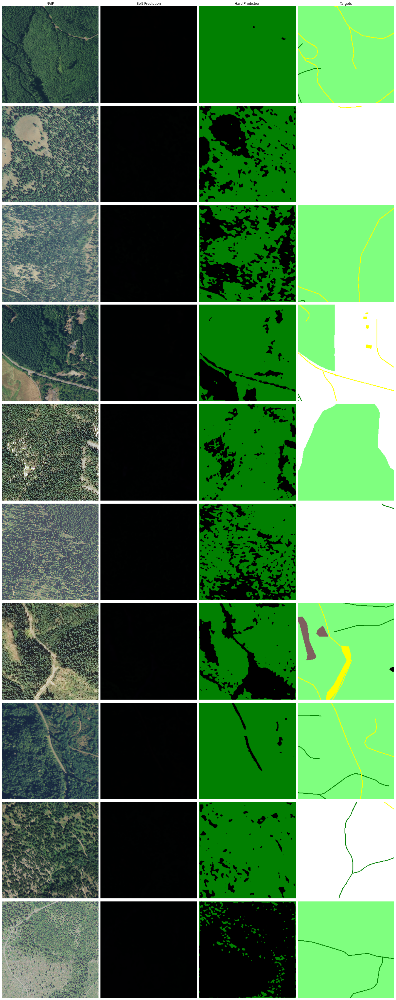

In [66]:
# display results from the last batch
num_chips = images.shape[0]
fig, axs = plt.subplots(NUM_CHIPS, 4, figsize=(20,5*num_chips))
for i in range(num_chips):
    axs[i, 0].imshow(images[i].detach().cpu().permute(1,2,0).numpy().astype(np.uint8)[:,:,0:3])
    pred_proba = F.softmax(sem_predict, dim=-1)[i].permute(1,2,0).cpu().detach().numpy()
    axs[i, 1].imshow(colorize_landcover(pred_proba, soft=True))
    axs[i, 2].imshow(colorize_landcover(sem_predict[i].argmax(dim=0).cpu().detach().numpy()) + 1)
    labels = sem_labels[i][0]
    labels[nodata[i][0]] = -1
    axs[i, 3].imshow(colorize_landcover(labels.cpu().detach().numpy() + 1))
for ax in axs.ravel():
    ax.axis('off')
axs[0,0].set_title('NAIP')
axs[0,1].set_title('Soft Prediction')
axs[0,2].set_title('Hard Prediction')
axs[0,3].set_title('Targets')

plt.tight_layout()
plt.show()

In [67]:
ls runs

Mar08_10-08-51_incubatorVMSemSeg/
events.out.tfevents.1615198123.incubatorVM.5445.0


In [60]:
# rm -r runs/*

In [61]:
# %tensorboard --logdir=runs --reload_multifile True
%tensorboard --logdir=runs

Reusing TensorBoard on port 6007 (pid 4590), started 0:35:12 ago. (Use '!kill 4590' to kill it.)

In [56]:
# %tensorboard dev upload --logdir runs


In [62]:
# %env NEPTUNE_API_TOKEN='token'

In [58]:
#!neptune tensorboard runs/ --project stand-mapping/sandbox